## Documentation and Summary
- Multivariate input and output: Using x_{1,2,...,T} and y_{1, 2,…, T-1} to predict y_T (4 dimensions to 1 dimension)
- The data is normalized before training and testing
- I have experimented different hyperparameters and the selected values here is: hidden states =20, lstm layer (stacked)= 1, batch size = 16, timestep = 100, learning rate = 0.001
- Outstanding problem:  NA
- Loss function (and also used as metrics here): MSE or MLE



### LSTM

In [1]:
import random
import numpy as np
import torch
import pandas as pd
# multivariate data preparation
from numpy import array
from numpy import hstack


In [2]:
import matplotlib.pyplot as plt

## Data Prepration: Visualize Data and Delete the date column

In [3]:
df = pd.read_csv("/content/bitcoin_yahoo.csv")
df

,Date,Open,High,Low,Close,Adj Close,Volume
0,2010-07-16,0.049510,0.049510,0.049510,0.049510,0.049510,0
1,2010-07-17,0.049510,0.085850,0.059410,0.085840,0.085840,5
2,2010-07-18,0.085840,0.093070,0.077230,0.080800,0.080800,49
3,2010-07-19,0.080800,0.081810,0.074260,0.074740,0.074740,20
4,2010-07-20,0.074740,0.079210,0.066340,0.079210,0.079210,42
...,...,...,...,...,...,...,...
3196,2019-04-16,5212.810059,5270.759766,5190.810059,5236.259766,5236.259766,194699629
3197,2019-04-17,5236.259766,5317.779785,5232.990234,5289.750000,5289.750000,187312150
3198,2019-04-18,5289.750000,5353.009766,5212.180176,5295.529785,5295.529785,158699049
3199,2019-04-19,5295.529785,5366.600098,5274.450195,5326.180176,5326.180176,123577001


In [4]:
df.rename(columns = {'Adj Close':'Adj_Close'}, inplace= True)

In [5]:
del df['Date']

In [6]:
from sklearn.preprocessing import MinMaxScaler

In [25]:
def normalize_data(df):
  close_scaler = MinMaxScaler()

  close_price = df.Close.values.reshape(-1, 1)

  scaled_close = close_scaler.fit_transform(close_price)

  
  open_scaler = MinMaxScaler()

  open_price = df.Open.values.reshape(-1, 1)

  scaled_open = open_scaler.fit_transform(open_price)


  adj_close_scaler = MinMaxScaler()

  adj_close = df.Adj_Close.values.reshape(-1, 1)

  scaled_adj_close = adj_close_scaler.fit_transform(adj_close)

  
  High_scaler = MinMaxScaler()

  high = df.High.values.reshape(-1, 1)

  scaled_high = High_scaler.fit_transform(high)


  low_scaler = MinMaxScaler()

  low = df.Low.values.reshape(-1, 1)

  scaled_low = low_scaler.fit_transform(low)

  
  volume_scaler = MinMaxScaler()

  volume = df.Volume.values.reshape(-1, 1)

  scaled_volume = volume_scaler.fit_transform(volume)

  df['Open'] = scaled_open
  df['High'] = scaled_high
  df['Low'] = scaled_low
  df['Close'] = scaled_close
  df['Adj_Close'] = scaled_open
  df['Volume'] = scaled_volume

  return df, close_scaler



In [26]:
def split_sequences(seq, n_steps):
    X, y = [], []
    for i in range(len(seq) - n_steps - 1):
        seq_x, seq_y = seq[i:(i + n_steps), :], seq[i + n_steps,:]
        X.append(seq_x)
        y.append(seq_y)
    return np.array(X), np.array(y)

In [27]:
class MV_LSTM(torch.nn.Module):
    def __init__(self,n_features,seq_length):
        super(MV_LSTM, self).__init__()
        self.n_features = n_features
        self.seq_len = seq_length
        self.n_hidden = 32 # number of hidden state's features
        self.n_layers = 1 # number of LSTM layers (stacked)
        self.l_lstm = torch.nn.LSTM(input_size = n_features, 
                                 hidden_size = self.n_hidden,
                                 num_layers = self.n_layers, 
                                 batch_first = True)
        self.l_linear = torch.nn.Linear(self.n_hidden*self.seq_len, self.n_features)
        
    
    def init_hidden(self, batch_size):
        hidden_state = torch.zeros(self.n_layers,batch_size,self.n_hidden).cuda()
        cell_state = torch.zeros(self.n_layers,batch_size,self.n_hidden).cuda()
        self.hidden = (hidden_state, cell_state)
    
    
    def forward(self, x):  
        #x = torch.from_numpy(x)      
        batch_size, seq_len, _  = x.size()
        
        lstm_out, self.hidden = self.l_lstm(x, self.hidden)
        # lstm_out(with batch_first = True) is 
        # (batch_size,seq_len,num_directions * hidden_size)
        # for following linear layer we want to keep batch_size dimension and merge rest       
        # .contiguous() -> solves tensor compatibility error
        x = lstm_out.contiguous().view(batch_size,-1)
        return self.l_linear(x)

In [28]:
df[-300:]

,Open,High,Low,Close,Adj_Close,Volume
2901,6260.399902,6286.359863,6067.490234,6088.390137,6088.390137,391396653
2902,6092.259766,6192.109863,6021.689941,6141.569824,6141.569824,383457137
2903,6141.569824,6172.229980,5844.259766,5871.279785,5871.279785,385907044
2904,5870.810059,6286.669922,5813.020020,6203.799805,6203.799805,554799001
2905,6203.810059,6503.330078,6194.509766,6385.379883,6385.379883,419284677
...,...,...,...,...,...,...
3196,5212.810059,5270.759766,5190.810059,5236.259766,5236.259766,194699629
3197,5236.259766,5317.779785,5232.990234,5289.750000,5289.750000,187312150
3198,5289.750000,5353.009766,5212.180176,5295.529785,5295.529785,158699049
3199,5295.529785,5366.600098,5274.450195,5326.180176,5326.180176,123577001


In [29]:
df[:-300]

,Open,High,Low,Close,Adj_Close,Volume
0,0.049510,0.049510,0.049510,0.049510,0.049510,0
1,0.049510,0.085850,0.059410,0.085840,0.085840,5
2,0.085840,0.093070,0.077230,0.080800,0.080800,49
3,0.080800,0.081810,0.074260,0.074740,0.074740,20
4,0.074740,0.079210,0.066340,0.079210,0.079210,42
...,...,...,...,...,...,...
2896,6761.270020,6790.080078,6687.660156,6720.640137,6720.640137,295690715
2897,6720.640137,6731.509766,5941.319824,6051.470215,6051.470215,862826624
2898,6051.470215,6257.879883,6033.200195,6166.540039,6166.540039,350697378
2899,6166.359863,6254.020020,5782.129883,6157.779785,6157.779785,667479078


In [30]:
n_features = 6 # this is number of parallel inputs
n_timesteps = 30 # this is number of timesteps

# train_prop = 0.8
# test_prop = 0.1
# val_prop = 0.1

#df_test = df[int(len(df)*(train_prop+val_prop)):]
df_test = df[-300:]
df_test, test_close_scaler = normalize_data(df_test)
sq_test = df_test.to_numpy()

# df_train = df[:int(len(df)*train_prop)]
df_train = df[:-300]
# df_val = df[int(len(df)*train_prop):int(len(df)*(train_prop+val_prop))]
df_train, _ = normalize_data(df_train)
# df_val = normalize_data(df_val)
sq_train = df_train.to_numpy()
#sq_val = df_val.to_numpy()

X_test, y_test = split_sequences(sq_test, n_timesteps)
X_train, y_train = split_sequences(sq_train, n_timesteps)
#X_valid, y_valid = split_sequences(sq_val, n_timesteps)

print(X_train.shape, y_train.shape)
#print(X_valid.shape, y_valid.shape)
print(X_test.shape, y_test.shape)

# create NN
mv_net = MV_LSTM(n_features,n_timesteps)
criterion = torch.nn.MSELoss(reduction='mean') # reduction='sum' created huge loss value
optimizer = torch.optim.Adam(mv_net.parameters(), lr=0.001)

train_episodes = 500
batch_size = 64

(2870, 30, 6) (2870, 6)
(269, 30, 6) (269, 6)


<ipython-input-25-b50e367a7779>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Open'] = scaled_open
<ipython-input-25-b50e367a7779>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['High'] = scaled_high
<ipython-input-25-b50e367a7779>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

In [31]:
# use GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
mv_net.to(device)
print(device)

cuda


In [32]:
mv_net.train()
best_loss = 10000000
loss_plot = []
val_loss_plot = []
for t in range(train_episodes):
    step_loss = 0
    for b in range(0, len(X_train), batch_size):
        if b + batch_size > len(X_train):
            break
        inpt = X_train[
            b : b + batch_size, :, :
        ]  # /np.linalg.norm(X_train[b:b+batch_size,:,:])
        target = y_train[
            b : b + batch_size
        ]  # /np.linalg.norm(y_train[b:b+batch_size])
        if target.shape[0] != 0:
            x_batch = (
                torch.from_numpy(inpt).float().to(device)
            )  # torch.tensor(inpt,dtype=torch.float32)
            y_batch = torch.from_numpy(
                target
            ).float()  # torch.tensor(target,dtype=torch.float32)
            mv_net.init_hidden(x_batch.size(0))
            output = mv_net(x_batch)
            loss = criterion(output.cpu(), y_batch)
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()
            step_loss += loss.item()

            # print(output.cpu())

    # validation
    val_loss = 0
    with torch.no_grad():
        for b in range(0, len(X_test), batch_size):
            if b + batch_size > len(X_test):
                break
            test_seq = X_test[b : b + batch_size, :, :]  
            label_seq = y_test[
                b : b + batch_size
            ]  
            x_batch = torch.from_numpy(test_seq).float().to(device)
            y_batch = torch.from_numpy(label_seq).float()
            mv_net.init_hidden(x_batch.size(0))
            try:
                output = mv_net(x_batch)
                # batch_val_loss = criterion(output.cpu().view(-1), np.transpose(y_batch))
                batch_val_loss = criterion(output.cpu(), y_batch)
                # infect_dist = torch.distributions.normal.Normal(y_batch, 0.1)
                # batch_val_loss = -infect_dist.log_prob(
                #     output.squeeze().cpu()
                # ).mean()
                val_loss += batch_val_loss.item()
            except:
                continue
                
    num_batches_train = len(X_train) // batch_size
    num_batches_test = len(X_test) // batch_size
    train_loss = step_loss / num_batches_train
    valid_loss = val_loss / num_batches_test
    loss_plot.append(train_loss)
    val_loss_plot.append(valid_loss)
    if valid_loss < best_loss:
        torch.save(mv_net.state_dict(), '/content/mse_lstm_state_dict_model.pt')
        best_loss = valid_loss

    print("step : ", t, "training loss : ", train_loss)
    print("step : ", t, "validation loss : ", valid_loss)

step :  0 training loss :  0.01037352768451621
step :  0 validation loss :  0.060740204993635416
step :  1 training loss :  0.013328772420539859
step :  1 validation loss :  0.015288203139789402
step :  2 training loss :  0.0028077756205468836
step :  2 validation loss :  0.017963447142392397
step :  3 training loss :  0.0083256915234787
step :  3 validation loss :  0.036613790900446475
step :  4 training loss :  0.0053272990936338
step :  4 validation loss :  0.017906802357174456
step :  5 training loss :  0.003481612974693152
step :  5 validation loss :  0.015942426398396492
step :  6 training loss :  0.003517088654007239
step :  6 validation loss :  0.019602583022788167
step :  7 training loss :  0.006606826204998387
step :  7 validation loss :  0.029130052193067968
step :  8 training loss :  0.0035419345623391896
step :  8 validation loss :  0.017681791097857058
step :  9 training loss :  0.0029239074268616605
step :  9 validation loss :  0.016046125208958983
step :  10 training lo

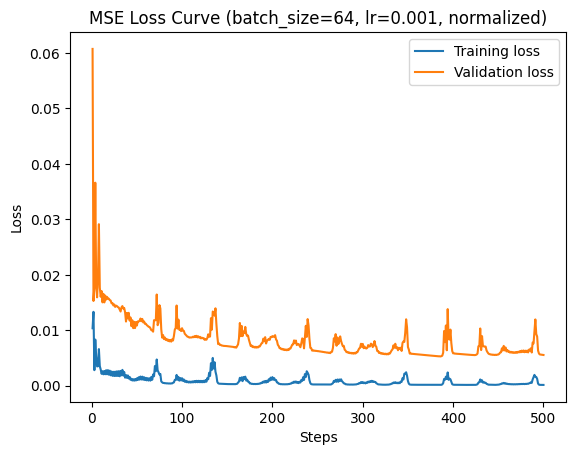

In [33]:
# Visualize training loss
updates = [i for i in range(1, len(loss_plot) + 1)]
plt.plot(updates, loss_plot, label="Training loss")
plt.plot(updates, val_loss_plot, label="Validation loss")
plt.title("MSE Loss Curve (batch_size=64, lr=0.001, normalized)")
plt.xlabel("Steps")
plt.ylabel("Loss")
plt.legend()
plt.show()

# Extrapolate

In [21]:
X_test.shape

(269, 30, 6)

In [22]:
y_test.shape

(269, 6)

In [42]:
mv_net = MV_LSTM(n_features,n_timesteps)
mv_net.load_state_dict(torch.load('/content/mse_lstm_state_dict_model.pt'))

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
mv_net.to(device)



preds = []
labels = []
losses = []
running_loss = 0

for i in range(len(X_test)):
  # start extrapolating from X_test[i]
  X_test_copy = X_test.copy()
  # y_test = y_test.copy()

  pred = []
  label = []
  if i + 30 > len(X_test):
    break
  # auto-regressively predict the next 30 days from i
  for j in range(i, i + 30):
    #print(i, j)
    X_trapolate = X_test_copy[j:j+1,:,:]
    #print(X_trapolate.shape)
    #test_seq = y_test[j]
    # print(X_trapolate.shape)
    with torch.no_grad():
      inpt = X_trapolate
      # replace label with predicted value to extrapolate
      for k in range(len(pred)):
        X_trapolate[0][-k] = pred[k]
      x_batch = (
          torch.from_numpy(inpt).float().to(device)
      )  
      mv_net.init_hidden(x_batch.size(0))
      output = mv_net(x_batch)
      t = output.cpu().view(-1).numpy()
      #print(t)
      # Produce output of the extrapolation
      pred.append([t[3]])
      label.append([y_test[j][3]])
  denormalized_pred = test_close_scaler.inverse_transform(np.array(pred))
  denormalized_label = test_close_scaler.inverse_transform(np.array(label))
  losses.append(np.square(denormalized_pred - denormalized_label).mean())  
  preds.append(denormalized_pred)
  labels.append(denormalized_label)
print("Average MSE across "+ str(len(losses))+ " time frame " + " is " + str(np.mean(losses)))        

Average MSE across 240 time frame  is 474948.5151512611


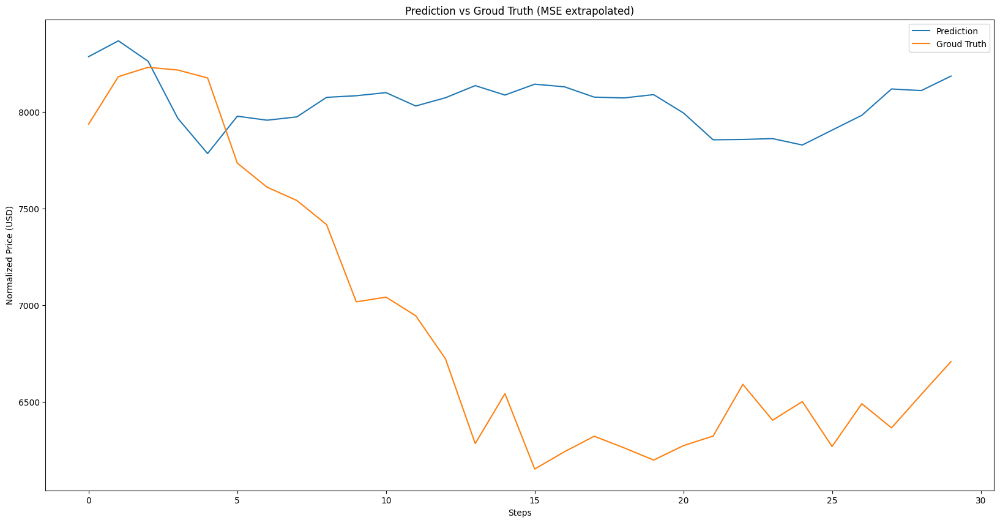

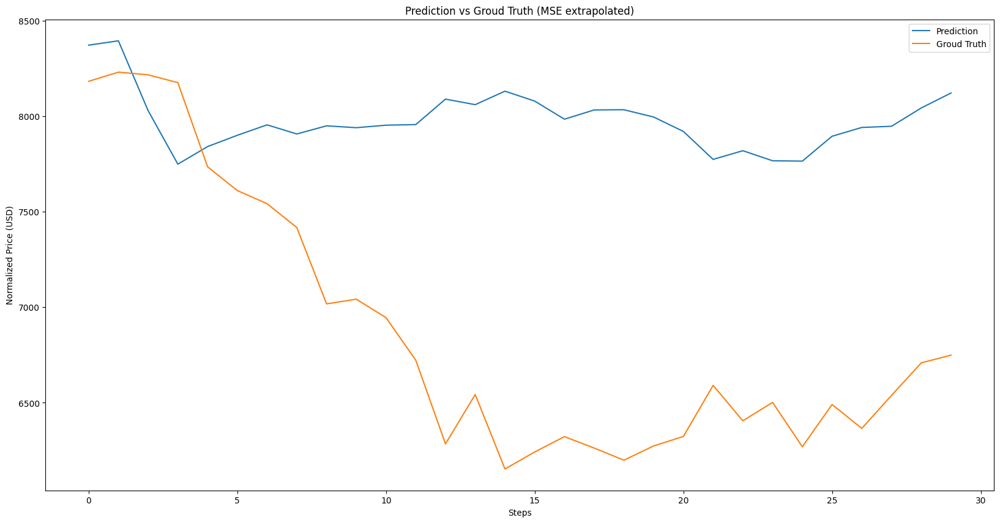

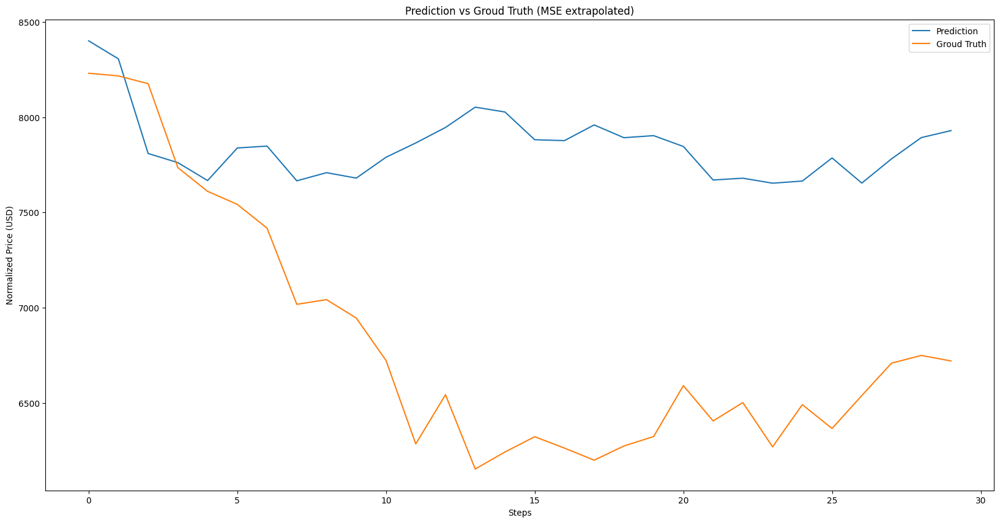

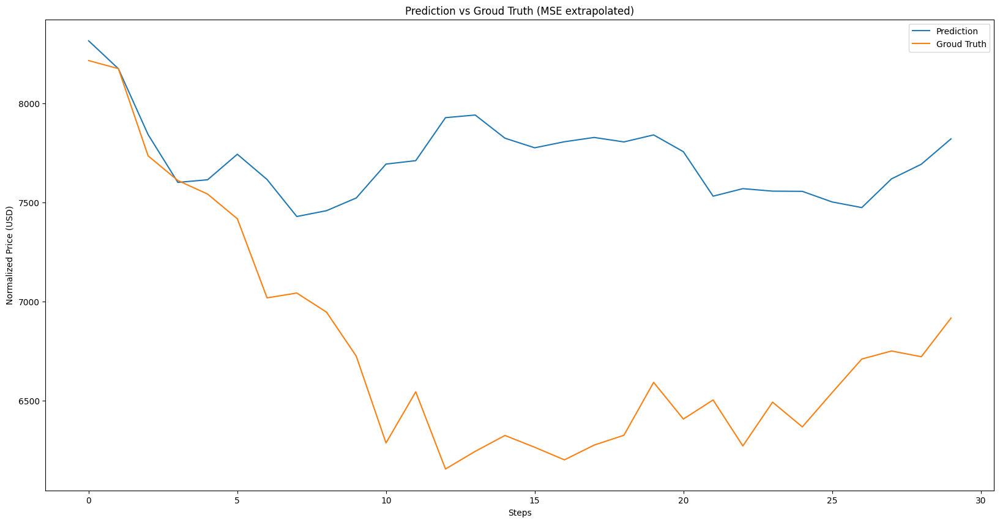

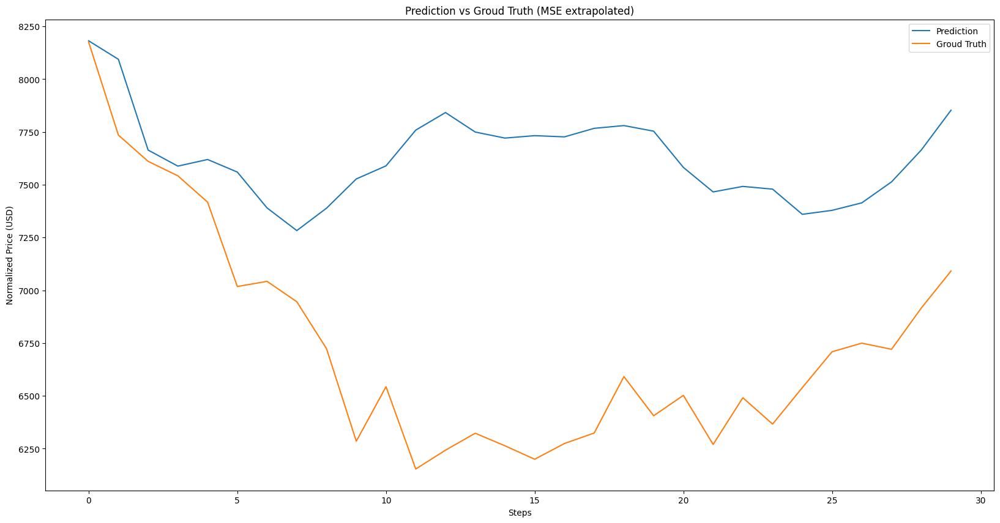

...

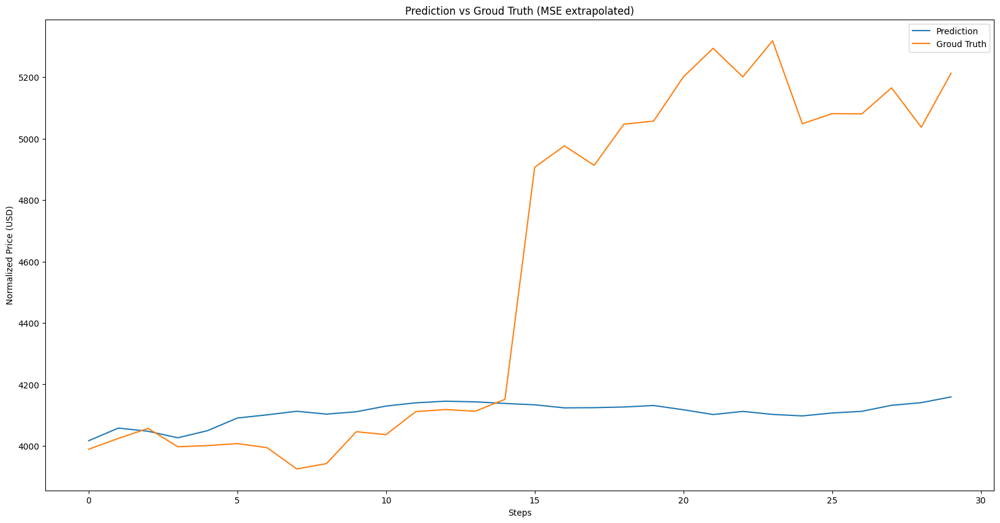

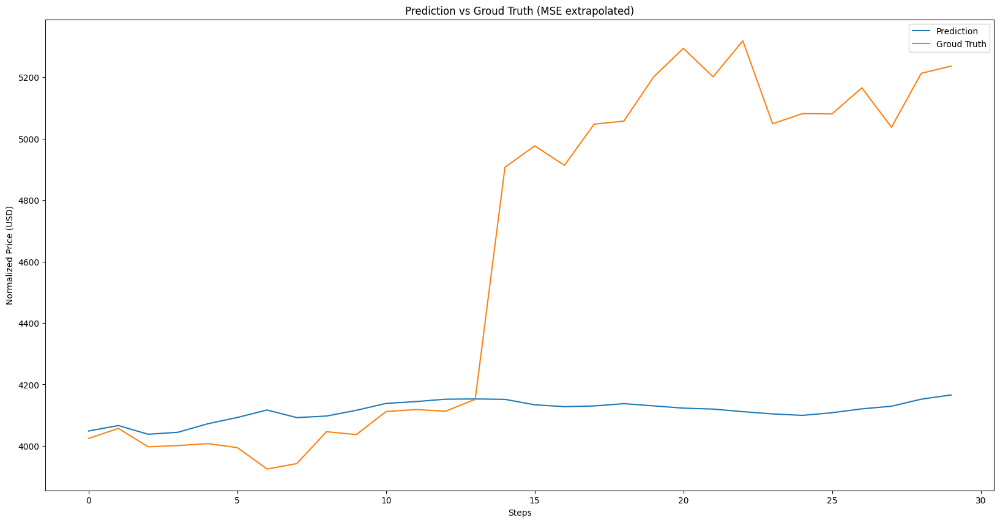

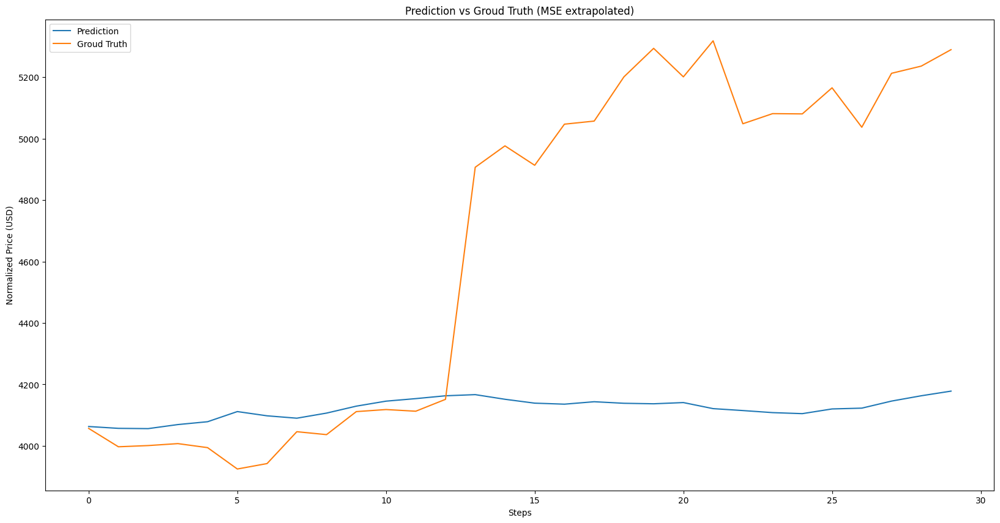

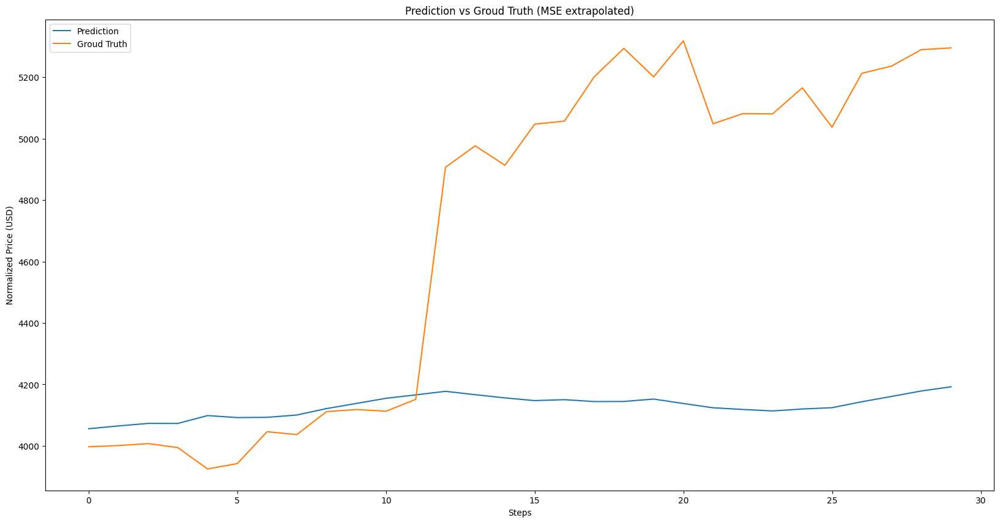

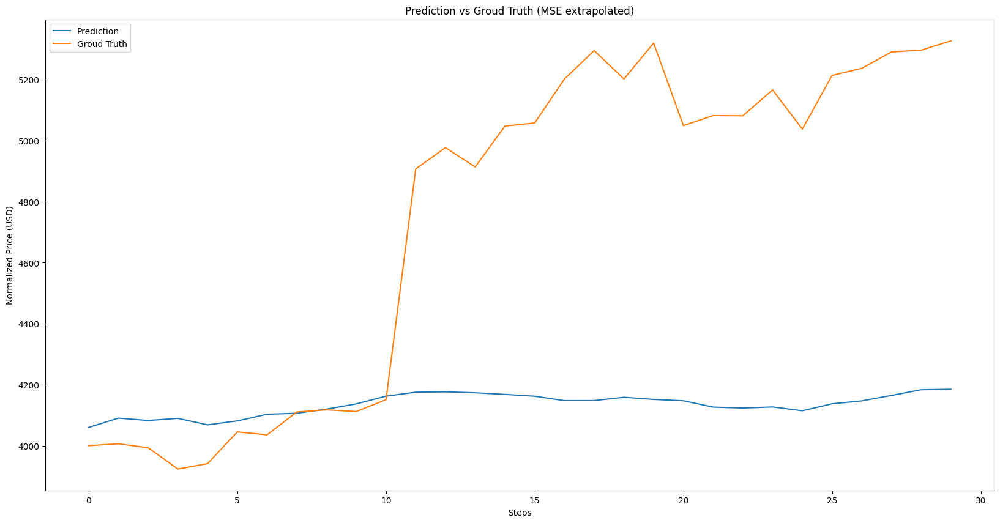

In [44]:
# Visualize preds vs labels
for j in range(len(preds)):
  pred = preds[j]
  label = labels[j]
  updates = [i for i in range(len(pred))]
  plt.figure(figsize=(20, 10))
  plt.plot(updates, pred, label="Prediction")
  plt.plot(updates, label, label="Groud Truth")
  plt.title("Prediction vs Groud Truth (MSE extrapolated)")
  plt.xlabel("Steps")
  plt.ylabel("Normalized Price (USD)")
  plt.legend()
  plt.show()
  #plt.savefig('')